Imported libraries

In [1]:
import numpy as np
import seaborn as sns
import numpy.random as random
import matplotlib.pyplot as plt
from IPython.display import HTML
import warnings
warnings.filterwarnings("ignore")
import matplotlib.patches as patches
import matplotlib.path as path
import matplotlib.animation as animation

Function use to create animation of convergence alongwith confidence interval values

In [2]:
def plot_(L,R,B,cur,rw_array1,rw_array2,rw_array3,lbound,rbound):
  def get_value(input):
    return L[input],B[input],R[input]
  def animate(i): # it updates plot during animation
      global rw_array1,rw_array2,rw_array3,cur,T
      for j in range(cur,cur+10):
        x,y,z = get_value(j)  
        rw_array1.append(x)
        rw_array2.append(y)
        rw_array3.append(z)
      cur+=10
      line1.set_data(np.arange(len(rw_array1)),np.array(rw_array1))
      line2.set_data(np.arange(len(rw_array2)),np.array(rw_array2))
      line3.set_data(np.arange(len(rw_array3)),np.array(rw_array3))
      return line1,line2,line3,

  def init(): #initialize animation
      line1.set_data([],[])
      line2.set_data([],[])
      line3.set_data([],[])
      return line1,line2,line3,

  T = len(L)
  fig = plt.figure()
  ax = fig.add_subplot(1,1,1)
  plt.ylim(lbound,rbound)
  plt.xlim(0,T)
  plt.xlabel('N (No of samples)')
  plt.ylabel('Estimated value')
  plt.title('Estimated value with 90% confidence interval')
  line1, = ax.plot([],[],lw=2)
  line2, = ax.plot([],[],lw=2)
  line3, = ax.plot([],[],lw=2)

  anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(L)//10-1, interval=50, blit=True)
  return anim

Function to return mean and variance

In [3]:
def calc(vec):
  return np.array(vec).mean(),np.array(vec).var()

# Q1

Function to calculate estimated value and 90% confidence interval value for PI

In [4]:
sample=[] # it stores generated random numbers
flag=[]  # it is true if sample falls within curve else stores false
L=[] #stores lower confidence interval
B=[] # estimated value
R=[] #upper confidence interval
random.seed=17
cur_count=[0]*100
for sample_size in range(3000):
  for j in range(100): # for each sample size we repeat it 100 times to get mean and variance
    X=random.uniform(-1,1)
    Y=random.uniform(-1,1)
    if j==0:
      sample.append([X,Y])
      if X**2+Y**2<=1: # point falls within circle
        flag.append(True)
      else:
        flag.append(False)
    if X**2+Y**2<=1:
      cur_count[j]+=1
  if sample_size<=0:
    continue
  mean,var=calc(cur_count)
  L.append((mean-1.64*(var**0.5)/10)*4/sample_size) # It is lower confidence interval
  B.append(mean*4/sample_size) #it is estimated value
  R.append((mean+1.64*(var**0.5)/10)*4/sample_size) # it is lower confidence interval

Scatter plot of Monte carlo simulation

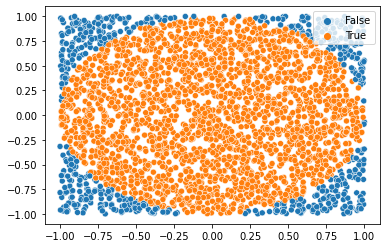

In [5]:
sns.scatterplot(np.array(sample)[:,0],np.array(sample)[:,1],hue=flag,)

Create animation of convergence

In [6]:
%%capture
cur=0
rw_array1=[]
rw_array2=[]
rw_array3=[]
rw_array4=[]
lbound=3
rbound=3.3
anim=plot_(L,B,R,cur,rw_array1,rw_array2,rw_array3,lbound,rbound)


Play animation (cell takes Approx ~30 sec to run)

In [7]:
HTML(anim.to_jshtml())

# Q2

This is given function to integrate

In [8]:
def f(x):
  return (-65536*(x**8) + 262144*(x**7) - 409600*(x**6) + 311296*(x**5) - 114688*(x**4) + 16384*(x**3))/27

First we get approximate bounds of function to get range of random numbers to be generated

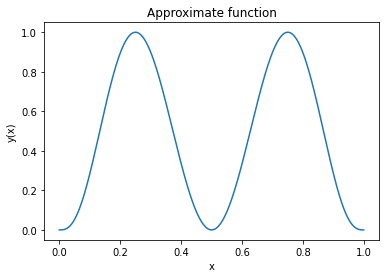

In [9]:
Y=[]
X=np.arange(0,1,0.001)
for x in X:
  Y.append(f(x))
plt.title('Approximate function')
plt.xlabel('x')
plt.ylabel('y(x)')
plt.plot(X,Y)

Now we have got approximate y-bound which is [0,1], we can apply monte carlo method to get estimate of integral of f(x)

In [10]:
sample=[] #stores generated samples
flag=[] #stores true if sample falls within x-axis and curve
L=[] #lower confidence interval
B=[] #estimated value
R=[]# upper confidence interval
random.seed=17
cur_count=[0]*100
for sample_size in range(2000):
  for j in range(100): # for each sample size we repeat it 100 times to get mean and variance
    X=random.uniform(0,1)
    Y=random.uniform(0,1)
    actual=f(X)
    if j==0:
      sample.append([X,Y])
      if Y<=actual: #points falling within x-axis and curve
        flag.append(True)
      else:
        flag.append(False)
    if Y<=actual:
      cur_count[j]+=1
  if sample_size<=0:
    continue
  mean,var=calc(cur_count)
  L.append((mean-1.64*(var**0.5)/10)/sample_size) #lower confidence interval
  B.append(mean/sample_size) #estimated value
  R.append((mean+1.64*(var**0.5)/10)/sample_size) # upper confidence interval

This is a static plot of monte carlo method.<br>
True- lies below f(x)<br>
False- lies above f(x)

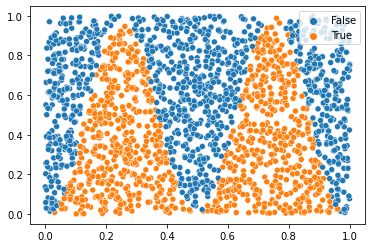

In [11]:
sns.scatterplot(np.array(sample)[:,0],np.array(sample)[:,1],hue=flag,)

Now we prepare simulation of whole process.

In [12]:
%%capture
cur=0
rw_array1=[]
rw_array2=[]
rw_array3=[]
rw_array4=[]
lbound=0.43
rbound=0.53
anim=plot_(L,B,R,cur,rw_array1,rw_array2,rw_array3,lbound,rbound)


Play simulation (cell takes Approx ~20 sec to run)

In [13]:
HTML(anim.to_jshtml())

Animate one of point drop

In [14]:
%%capture
def animate(i):
    global rw_array1,rw_array2,cur,N
    for j in range(cur,cur+10):
      if flag[j]==True:
        rw_array1.append(sample[j][0])
        rw_array2.append(sample[j][1])
      else:
        rw_array3.append(sample[j][0])
        rw_array4.append(sample[j][1])
    cur+=10
    line1.set_data(rw_array1,rw_array2)
    line2.set_data(rw_array3,rw_array4)
    return line1,line2,

def init():
    line1.set_data([],[])
    line2.set_data([],[])
    return line1,line2,

N = 2000
optimize=10
rw_array1=[]
rw_array2=[]
rw_array3=[]
rw_array4=[]
cur=0
fig = plt.figure()
ax = fig.add_subplot(1,1,1)
plt.ylim(0,1)
plt.xlim(0,1)
plt.xlabel('t')
plt.title('Animation of points for n=2000')
line1, = ax.plot([],[],'ro',)
line2, = ax.plot([],[],'ko',)

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=N//optimize, interval=50, blit=True)

Play simulation (cell takes Approx ~20 sec to run)

In [15]:
HTML(anim.to_jshtml())

# Q3


Target distribution and proposal distribution function

In [16]:
def f(x):
  return 1/(2*np.pi)**0.5*np.exp(-x**2/2)
def g(x):
  return 1/(np.pi*(1+x**2))

Calculated value for M, using maximization of ratio of distribution

In [17]:
M=(2*np.pi)**0.5*np.exp(-1/2)
print('Calculated value of M : ',M)

Calculated value of M :  1.5203469010662807


Now sample the distribution using rejection sampling

In [18]:
X=random.standard_cauchy(10000)
accept=[]
reject=[]
for x in X:
  u=random.uniform(0,1)
  if u<=f(x)/(M*g(x)): # aceptence condition
    accept.append(x)
  else:
    reject.append(x)

get densities to plot

In [19]:
idx=np.array(X)
idx=idx[(idx<10) & (idx>-10)]
scaled_proposal=[]
proposal=[]
for i in sorted(idx):
  scaled_proposal.append(M*g(i))
  proposal.append(g(i))

Plot of proposal, scaled proposal, target distribution

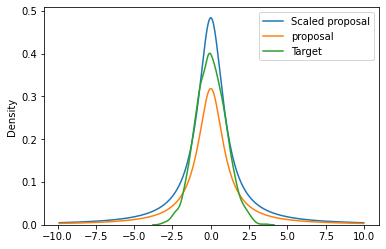

In [20]:
plt.plot(sorted(idx),scaled_proposal)
plt.plot(sorted(idx),proposal)
sns.kdeplot(accept)
plt.legend(['Scaled proposal','proposal','Target'])

Fucntion to create animated histogram

In [21]:
%%capture
data     = 0
n_bins   = 50
n, bins  = np.histogram(data, n_bins)
meanList = []
x_min    = -2.5
x_max    =  2.5
left   = np.array(bins[:-1])
right  = np.array(bins[1:])
bottom = np.zeros(len(left))
top    = bottom + n
nrects = len(left)
nverts = nrects * (1 + 3 + 1)
verts  = np.zeros((nverts, 2))
codes  = np.ones(nverts, int) * path.Path.LINETO
codes[0::5] = path.Path.MOVETO
codes[4::5] = path.Path.CLOSEPOLY
verts[0::5, 0] = left
verts[0::5, 1] = bottom
verts[1::5, 0] = left
verts[1::5, 1] = top
verts[2::5, 0] = right
verts[2::5, 1] = top
verts[3::5, 0] = right
verts[3::5, 1] = bottom
patch = None
j=0
def animate(i):
    global meanList,j
    for i in range(j,25+j):
        meanList.append(accept[i])
    j+=25
    n, bins = np.histogram(meanList, 50,range=(x_min,x_max),density=False)
    top = bottom + n
    verts[1::5, 1] = top
    verts[2::5, 1] = top
    return [patch, ]
fig, ax = plt.subplots(figsize=(10, 5))
barpath = path.Path(verts, codes)
patch = patches.PathPatch(
    barpath, facecolor='darkmagenta', edgecolor='crimson', alpha=0.5)
ax.add_patch(patch)
ax.set_xlim(-1,1)
ax.set_ylim(0,330)
plt.xlabel('x')
plt.ylabel('f(x)')
n_frames = len(accept)//25-2
anim = animation.FuncAnimation(fig, animate, n_frames,interval=50, repeat=True, blit=False)

Play animation (approx ~25 sec to run)

In [22]:
HTML(anim.to_jshtml())

# Q4

given proposal and target distributions

In [23]:
def p(x):
  return 1/2*np.exp(-abs(x))
def f(x,pow):
  return x**pow
def g(x):
  return (1/(2*np.pi)**0.5)*1/2*np.exp(-1/2*(x**2)/4)

Estimating moments using Importance sampling<br>
For calculating error-<br>
-> while calculating 1 th and 5th moment, moment calculating function becomes odd, so actual mean is zero<br>
->for 2nd moment and function becomes even, then using integral transformation for even function, function simply becomes 2nd moment of exponential function with parameter 1, and hence actual value is 2

In [24]:
for N in [100,500,1000]:
  X=random.normal(0,2,N)
  print('\n\nNo of samples : ',N)
  plt.show()
  for pow in [1,2,5]:
    mean=0
    for x in X:
      mean+=f(x,pow)*p(x)/g(x)
    error=abs(mean/N)
    if pow==2:
      error=abs(2-mean/N)
    print('  ->',pow,'th Moment : ',mean/N)
    print('     absolute error : ',error)



No of samples :  100
  -> 1 th Moment :  -0.07529538316607126
     absolute error :  0.07529538316607126
  -> 2 th Moment :  1.8129395768690901
     absolute error :  0.18706042313090987
  -> 5 th Moment :  42.9153009711061
     absolute error :  42.9153009711061


No of samples :  500
  -> 1 th Moment :  0.07901102223253173
     absolute error :  0.07901102223253173
  -> 2 th Moment :  2.071876127186756
     absolute error :  0.07187612718675584
  -> 5 th Moment :  66.80788890154783
     absolute error :  66.80788890154783


No of samples :  1000
  -> 1 th Moment :  -0.03639194659874908
     absolute error :  0.03639194659874908
  -> 2 th Moment :  1.882260875463623
     absolute error :  0.11773912453637703
  -> 5 th Moment :  -13.084060489741278
     absolute error :  13.084060489741278


# Q5

Using inverse transform we calculate inverse function and it comes out to be y=(40*x+9/4)**0.5-3/2<br>
Now we will be sample from this function.

In [25]:
sampled=[]
for i in range(10000):
  x=random.uniform(0,1)
  sampled.append((40*x+9/4)**0.5-3/2)

This is expected distribution

In [26]:
expected=[1/40*(2*x+3) for x in np.arange(0,5,0.01)]

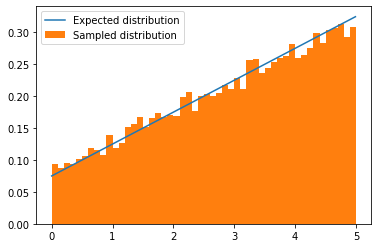

In [27]:
plt.plot(np.arange(0,5,0.01),expected)
plt.hist(sampled,bins=50,density=True)
plt.legend(['Expected distribution','Sampled distribution'])
plt.show()

# Q6

We start from origin and move around randomly in 2d plane with x and y coordinate changing by Unif(-1,1)

In [28]:
%%capture
N=1000
lbound=50
ubound=50
random.seed=42
def random_walk(input1,input2):
    return input1+random.uniform(-1,1),input2+random.uniform(-1,1)

def animate(i):
    global rw_array1,rw_array2,lim,T,x,y
    x,y = random_walk(x,y)
    x=x%(2*lbound)
    y=y%(2*ubound)
    rw_array1.append(x-lbound)
    rw_array2.append(y-ubound)
    x,y = random_walk(x,y)
    x=x%(2*lbound)
    y=y%(2*ubound)
    rw_array1.append(x-lbound)
    rw_array2.append(y-ubound)
    x,y = random_walk(x,y)
    x=x%(2*lbound)
    y=y%(2*ubound)
    rw_array1.append(x-lbound)
    rw_array2.append(y-ubound)
    line.set_data(np.array(rw_array1),np.array(rw_array2))
    return line,

def init():
    line.set_data([],[])
    return line,

T = 1000
optimize=3
rw_array1=[]
rw_array2=[]
lim = 0
x=lbound
y=ubound
fig = plt.figure()
ax = fig.add_subplot(1,1,1)
plt.ylim(-ubound,ubound)
plt.xlim(-lbound,lbound)
plt.xlabel('t')
plt.title('2D Random Walk')
line, = ax.plot([],[],lw=1,ls='-',marker='.',markersize=0.1,)

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=T//optimize, interval=100, blit=True)

Play animation (approx ~20 secs to run cell)

In [29]:
HTML(anim.to_jshtml())

# Q7

We generate bivariate distribution with cov(X,Y)=cov(Y,X)=0 and some positive cov(X)=cov(Y)

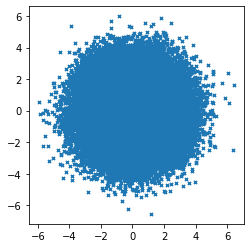

In [30]:
c=2
cov=[[c,0],[0,c]]
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_aspect('equal', adjustable='box')
X=random.multivariate_normal([0,0],cov,100000)
plt.scatter(X[:,0],X[:,1],marker="x",s=10)


From above plot we can see that the plot is symmetric and has equal spread along both directions.



We generate bivariate distribution with cov(X,Y)=cov(Y,X)=0 and some positive cov(X) not equals cov(Y)

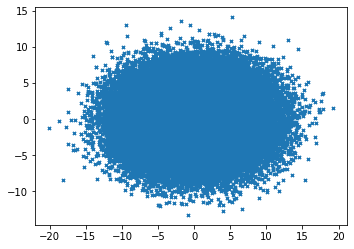

In [31]:
c1=20
c2=10
cov=[[c1,0],[0,c2]]
fig = plt.figure()
ax = fig.add_subplot(111)
ax.set_aspect('equal', adjustable='box')
X=random.multivariate_normal([0,0],cov,100000)
plt.scatter(X[:,0],X[:,1],marker="x",s=10)

From above plot we can see that the plots are symmetric about particular axes but spread is more along the x-axis.

We generate bivariate distribution with cov(X,Y)=-cov(Y,X) not equals zero and some positive random values for  cov(X),ov(Y)

on diagonal entries- 2 2


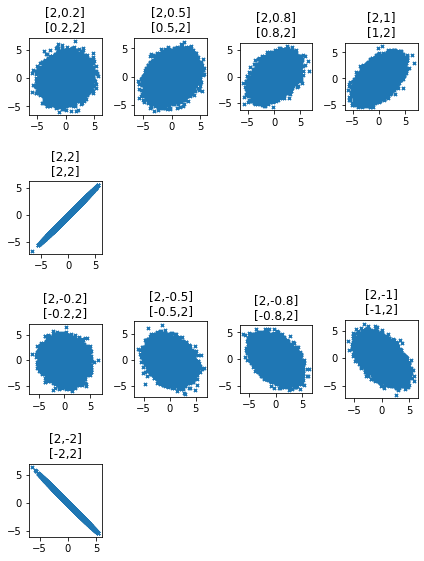

on diagonal entries- 3 3


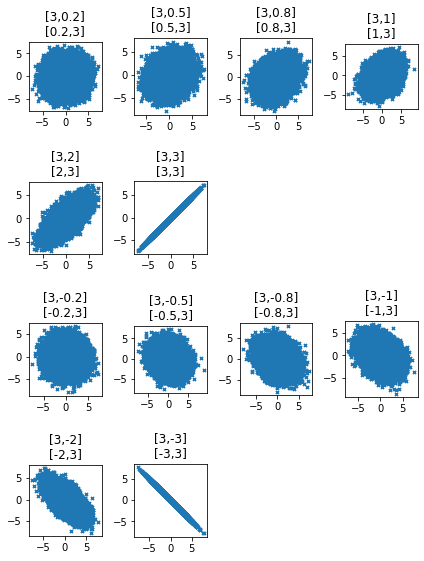

on diagonal entries- 10 10


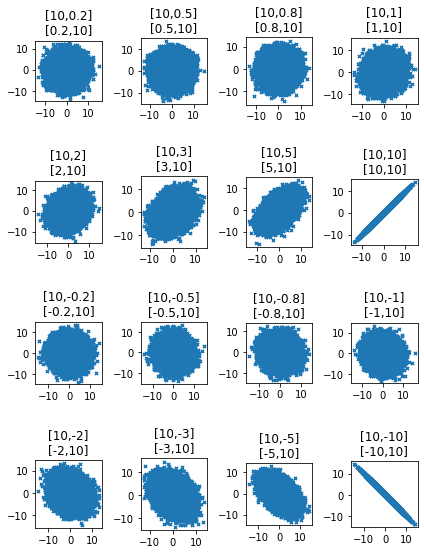

on diagonal entries- 20 20


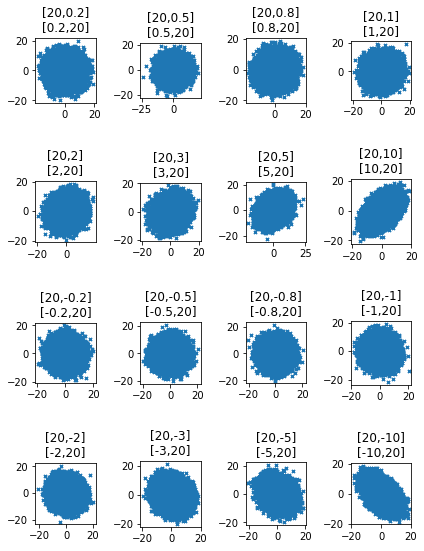

In [32]:
on=[[2,2],[3,3],[10,10],[20,20]] # this is used to iterate over on diagonal values
off=[0.2,0.5,0.8,1,2,3,5,10,-0.2,-0.5,-0.8,-1,-2,-3,-5,-10] # this is used to iterate over off diagonal values
for i in range(len(on)):
  print("on diagonal entries-",on[i][0],on[i][1])
  
  plt.rcParams["figure.figsize"] = (6,8)
  fig = plt.figure()
  for j in range(len(off)):
    cov=[[on[i][0],off[j]],[off[j],on[i][1]]]
    if(cov[0][0]*cov[1][1]-cov[0][1]*cov[1][0]<0): #check for postive semii definite
      continue
    num=2
    if i==0:
      num=1
    ax = fig.add_subplot(4,4,j+1)
    ax.set_aspect('equal', adjustable='box')
    X=random.multivariate_normal([0,0],cov,100000)
    title="["+str(cov[0][0])+","+str(cov[0][1])+"]\n"+"["+str(cov[1][0])+","+str(cov[1][1])+"]"
    plt.title(title)
    plt.scatter(X[:,0],X[:,1],marker="x",s=10)
  plt.tight_layout()
  plt.show()

If we observe the plots, for a fixed value of principal diagonal values, on increasing magnitude of off-diagonal values the linearity in plot is increased. If we increase in positive direction then linearity is introduced in such a manner that slope becomes positive, while in other case slope becomes more and more negative.<br>
Yes, it is true for other kinds of distribution, because covariance introduces linearity in data.